In [1]:
import os
import numpy as np
import h5py
import matplotlib.pyplot as plt
from exm.io.io import nd2ToVol
import re
%matplotlib inline

os.environ["HDF5_USE_FILE_LOCKING"] = "FALSE"

In [2]:
parent_dir = '/mp/nas2/jlove/alignment/zebrafish/20220801/code3'
files = os.listdir(parent_dir)
ref_code_path = '/mp/nas2/ruihan/20220801_zebrafish/20220801_Code0/Channel405 SD_Seq0004.nd2'

# viz 405

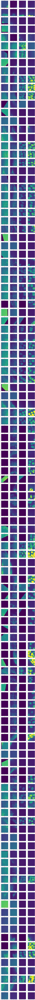

In [10]:
fig, ax = plt.subplots(len(files)-2,4,figsize = (20,5*(len(files)-2)))

for ind, file in enumerate(files[2:]):
    
    fov = int(re.search(r'\d+', file).group())
    vol = nd2ToVol(ref_code_path, fov)
    
    h5_path = os.path.join(parent_dir, file)
    
    with h5py.File(h5_path, 'r') as f:
        img = f['main']
        
        ax[ind,0].imshow(img[75,:,:])
        ax[ind,1].imshow(vol[75,:,:])
        
        ax[ind,2].imshow(img[75,1000:1500,1250:1750], vmax = 400)
        ax[ind,3].imshow(vol[75,1000:1500,1250:1750], vmax = 400)
        
        ax[ind,0].set_title(f'fov = {fov}')
        ax[ind,1].set_title(f'fov = {fov}')

# viz other channels (overwrite)

In [ ]:
fig, ax = plt.subplots(len(files[2:]),4,figsize = (20,5*(len(files[2:]))))

channel_names = ['488','561','594','640']

for ind, file in enumerate(files[2:]):
    
    fov = int(re.search(r'\d+', file).group())
    
    h5_path = os.path.join(parent_dir, file)
    
    for col, channel in enumerate(channel_names):
        with h5py.File(h5_path, 'r') as f:
            
            try:
            
                result = f[channel]
                
                ax[ind,col].imshow(result[75,:,:], vmax = 400)
                
                ax[ind,col].set_title(f'fov = {fov}, channel = {channel}, code = 1')
                
            except:
                print(f'no {channel} in {file}')

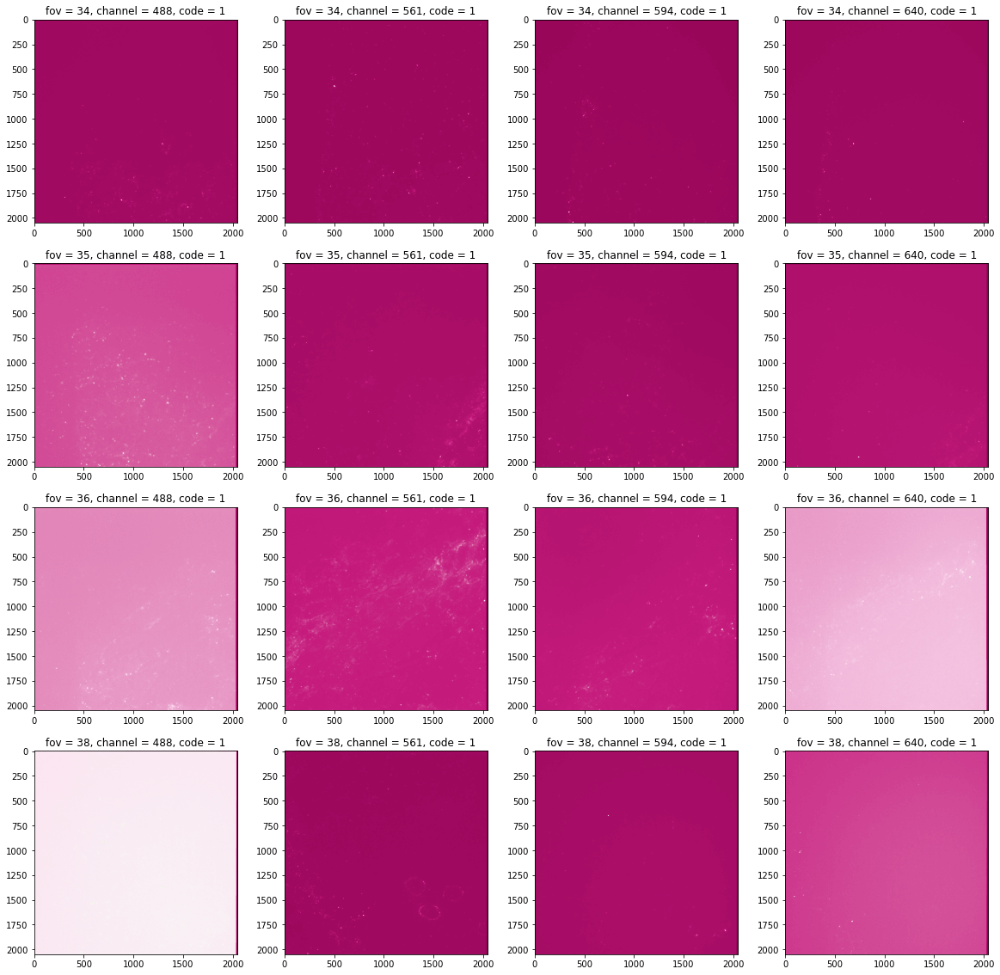

In [19]:
fig, ax = plt.subplots(len(files[-4:]),4,figsize = (20,5*(len(files[-4:]))))

channel_names = ['488','561','594','640']

for ind, file in enumerate(files[-4:]):
    
    fov = int(re.search(r'\d+', file).group())
    
    h5_path = os.path.join(parent_dir, file)
    
    for col, channel in enumerate(channel_names):
        with h5py.File(h5_path, 'r') as f:
            
            result = f[channel]
            
            ax[ind,col].imshow(result[75,:,:], cmap = 'PiYG')
            
            ax[ind,col].set_title(f'fov = {fov}, channel = {channel}, code = 1')